# Sistematic Way To Detect Artifacts In Images
We will analyse the SIFT Matching Points in a sistematic way to create a POC (Proof Of Concept) of Artifacts Detection in Images. All images in the database configured will be analysed. Once found the best parameters and conditions to any image in the database the POC will be proved by generating great results.

### 1. Load libraries and models configured in the database

In [1]:
#%matplotlib notebook
#%matplotlib inline


%load_ext autoreload
%autoreload 2

import cv2 
import matplotlib.pyplot as plt
import numpy as np
from cv2 import cv2
import ModelsConfiguration as config

models = config.GetModelsConfigured()

#### 1.1 Enumeration of  Models and images in database configured

In [2]:
for model in models:
    print(model['Name'] + ' [OK-NG]: ' + str(len(model['OK']['Images'])) + '-' + str(len(model['NG']['Images'])))

CAUIM [OK-NG]: 3-3
DEMOISELLE [OK-NG]: 3-3
GOLDEN [OK-NG]: 3-3
INDICA [OK-NG]: 3-3
WITBIER [OK-NG]: 3-3


### 2. Creating SIFT features

The best params was found by the Notebook "Analysing SIFT Matching Points"

In [3]:
sift_label = cv2.SIFT_create(nfeatures=0, nOctaveLayers=30, contrastThreshold=0.04, edgeThreshold=10, sigma=1.6)

In [4]:
sift_label = cv2.SIFT_create(nfeatures=0, nOctaveLayers=30, contrastThreshold=0.04, edgeThreshold=10, sigma=1.6)

img_label = cv2.imread('.\\images\\Models\\' + models[0]['Name'] + '\\' +  models[0]['Label']['Images'][0])
keypoints, descriptors = sift_label.detectAndCompute(img_label, None)

#Add Features
models[0]['Label']['Features'].append({ 'Keypoints': keypoints, 'Descriptors': descriptors })

In [5]:

#Accessing objects

models[0]['Label']['Features'][0]['Keypoints'][0]
models[0]['Label']['Features'][0]['Descriptors'][0]

array([  0.,   0.,   0.,   0.,   0.,   0.,   1.,   1.,   0.,   0.,   0.,
         0.,   0.,   2.,   9.,   3.,   0.,   0.,   0.,   0.,   0.,   4.,
         5.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   8.,
         1.,   0.,   0.,   0.,   0.,   0.,   2.,  80.,   4.,   0.,   0.,
         4.,  37.,  48.,  74.,  10.,   0.,   0.,   0.,  34., 133.,  37.,
        16.,   0.,   0.,   0.,   0.,   4.,   6.,   0.,   0.,  14.,   2.,
         0.,   0.,   0.,   0.,   0.,   0., 166.,  25.,   0.,   0.,   4.,
        34.,  15.,  38., 106.,   3.,   0.,   2., 154., 166.,  28.,  32.,
         0.,   3.,   4.,   6.,  50.,  35.,   0.,   0.,   7.,   1.,   0.,
         0.,   0.,   0.,   0.,   0., 166.,  19.,   0.,   0.,   1.,   4.,
         3.,  10., 166.,   7.,   6.,  60., 166.,  96.,  11.,  17.,   7.,
        72.,  36.,  64., 141.,  12.,   0.,   0.], dtype=float32)

# 3 Systematic Analysis

Here all the database will be analysed

In [6]:
# Systematic parameters
root_path = '.\\images\\Models\\'
show_labels = False
show_OK_images = False
show_NG_images = False
draw_keypoints_labels = True
draw_keypoints_images_OK = True
draw_keypoints_images_NG = True


# Best parameters found to create SIFT
p_nfeatures = 0
p_nOctaveLayers = 30
p_contrastThreshold = 0.04
p_edgeThreshold = 10
p_sigma = 1.6


# Matching parameters
p_TwoSidesCheck = False
p_QuantitiesOfTheBestMatchings = 2

In [7]:
for model in models:
    for label_image in model['Label']['Images']:
        img = cv2.imread(root_path + model['Name'] + '\\' +  label_image)
        model['Label']['ImagesReaded'].append(img)
        
        if show_labels:
            plt.figure(figsize=[15, 7])
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

        sift = cv2.SIFT_create(nfeatures = p_nfeatures, nOctaveLayers = p_nOctaveLayers, 
                               contrastThreshold = p_contrastThreshold, edgeThreshold = p_edgeThreshold, sigma = p_sigma)
        keypoints, descriptors = sift.detectAndCompute(img, None)
        
        model['Label']['SIFT'].append(sift)
        model['Label']['Features'].append( { 'Keypoints': keypoints, 
                                             'Descriptors': descriptors } )

        
    for OK_image in model['OK']['Images']:
        img = cv2.imread(root_path + model['Name'] + '\\OK\\' +  OK_image)
        model['OK']['ImagesReaded'].append(img)
        
        if show_OK_images:
            plt.figure(figsize=[15, 7])
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            
        sift = cv2.SIFT_create(nfeatures = p_nfeatures, nOctaveLayers = p_nOctaveLayers, 
                               contrastThreshold = p_contrastThreshold, edgeThreshold = p_edgeThreshold, sigma = p_sigma)
        keypoints, descriptors = sift.detectAndCompute(img, None)
        
        model['OK']['SIFT'].append(sift)
        model['OK']['Features'].append( { 'Keypoints': keypoints, 
                                          'Descriptors': descriptors } )
    
    for NG_image in model['NG']['Images']:
        img = cv2.imread(root_path + model['Name'] + '\\NG\\' +  NG_image)
        model['NG']['ImagesReaded'].append(img)
        
        if show_NG_images:
            plt.figure(figsize=[15, 7])
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        
        sift = cv2.SIFT_create(nfeatures = p_nfeatures, nOctaveLayers = p_nOctaveLayers, 
                               contrastThreshold = p_contrastThreshold, edgeThreshold = p_edgeThreshold, sigma = p_sigma)
        keypoints, descriptors = sift.detectAndCompute(img, None)
        
        model['NG']['SIFT'].append(sift)
        model['NG']['Features'].append( { 'Keypoints': keypoints, 
                                          'Descriptors': descriptors } )


## 4.1 Drawing keypoints on label

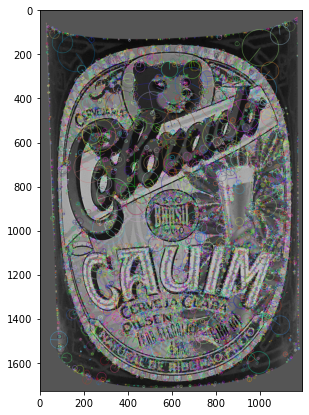

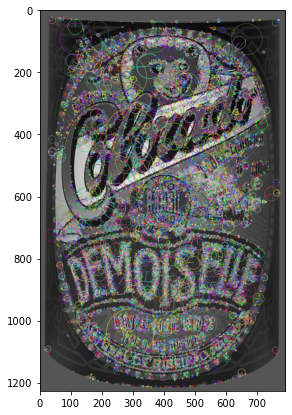

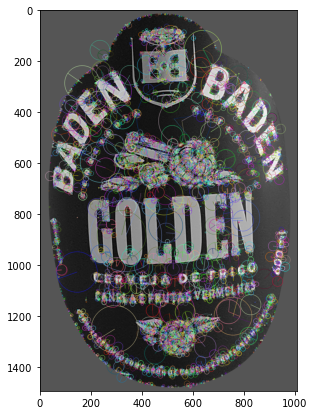

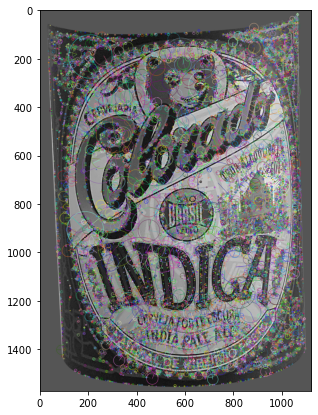

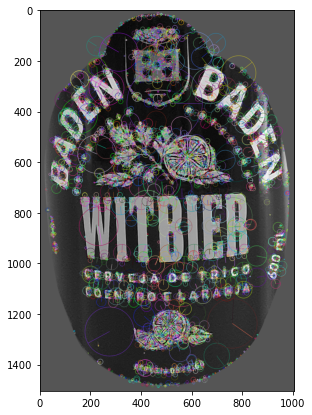

In [8]:
if draw_keypoints_labels:
    
    for model in models:
        for idx, image in enumerate(model['Label']['ImagesReaded']):
            
            image_keypoints = np.zeros([image.shape[0], image.shape[1], 3], dtype=np.uint8)
            cv2.drawKeypoints(image, model['Label']['Features'][idx]['Keypoints'], image_keypoints, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
            plt.figure(figsize=[15, 7])
            plt.imshow(image_keypoints)

## 4.2 Draw Keypoints on OK images

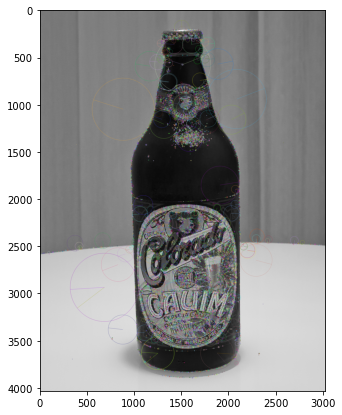

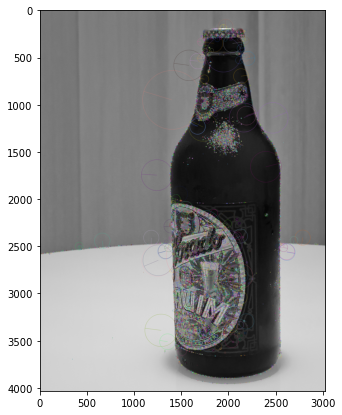

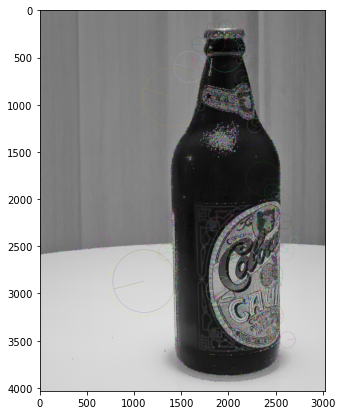

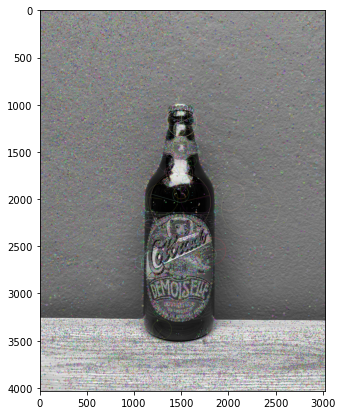

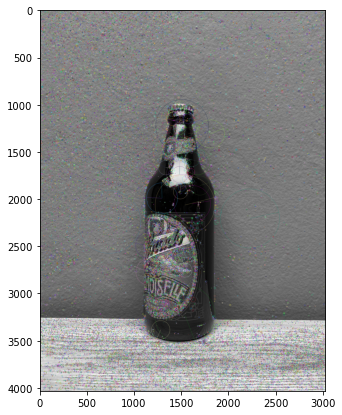

...

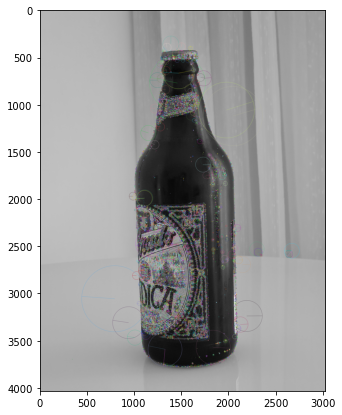

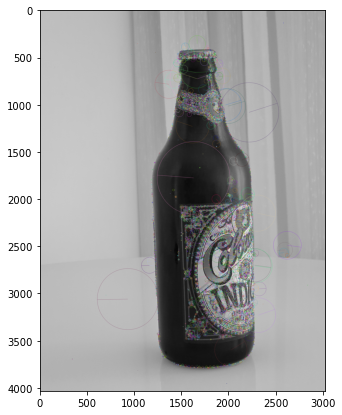

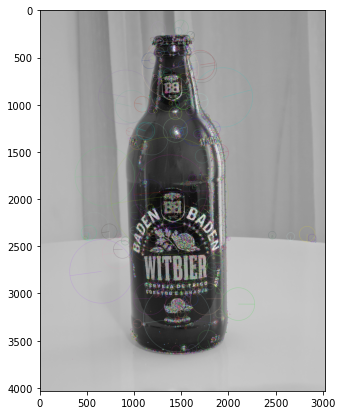

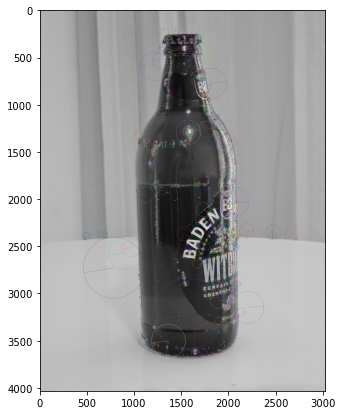

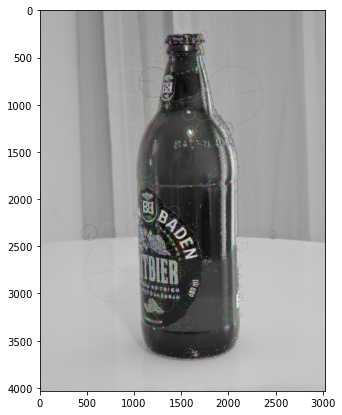

In [9]:
if draw_keypoints_images_OK:
    
    for model in models:
        for idx, image in enumerate(model['OK']['ImagesReaded']):
            image_keypoints = np.zeros([image.shape[0], image.shape[1], 3], dtype=np.uint8)
            cv2.drawKeypoints(image, model['OK']['Features'][idx]['Keypoints'], image_keypoints, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
            plt.figure(figsize=[15, 7])
            plt.imshow(image_keypoints)

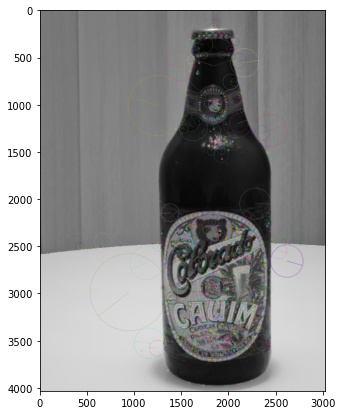

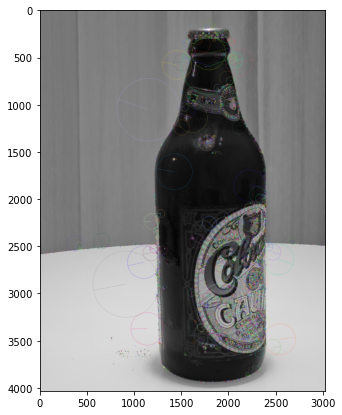

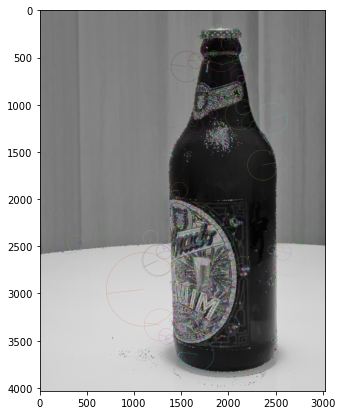

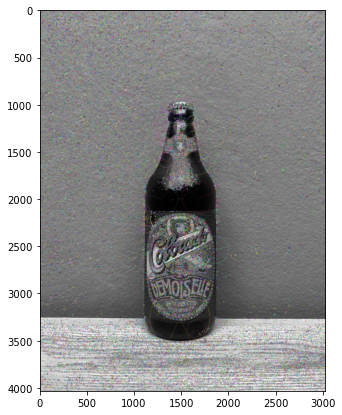

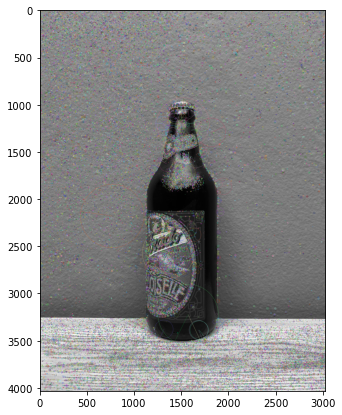

...

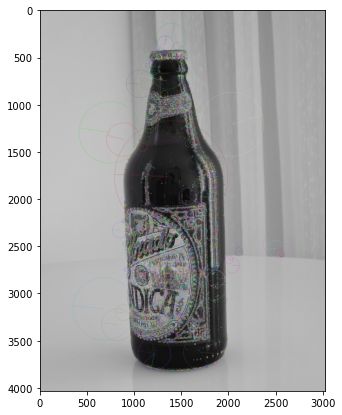

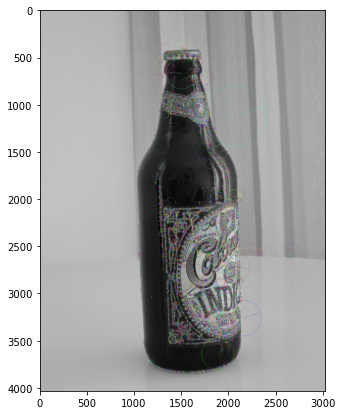

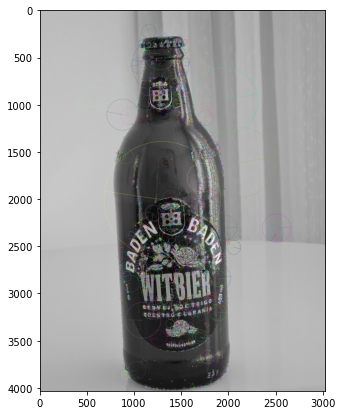

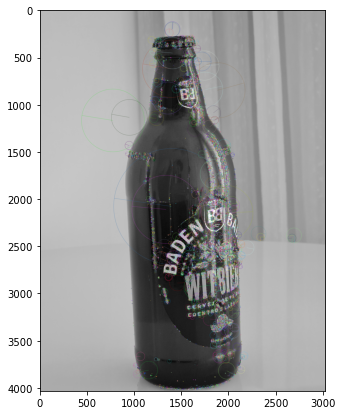

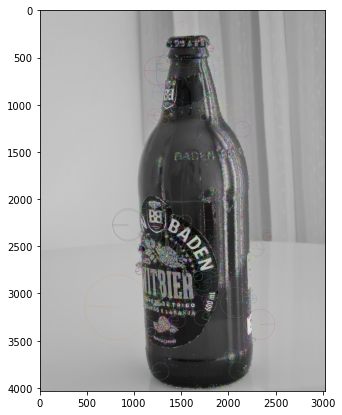

In [10]:
if draw_keypoints_images_NG:
    
    for model in models:
        for idx, image in enumerate(model['NG']['ImagesReaded']):
            image_keypoints = np.zeros([image.shape[0], image.shape[1], 3], dtype=np.uint8)
            cv2.drawKeypoints(image, model['NG']['Features'][idx]['Keypoints'], image_keypoints, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
            plt.figure(figsize=[15, 7])
            plt.imshow(image_keypoints)

# 5 Features Matching
Here the points will be matched among labels and scenes

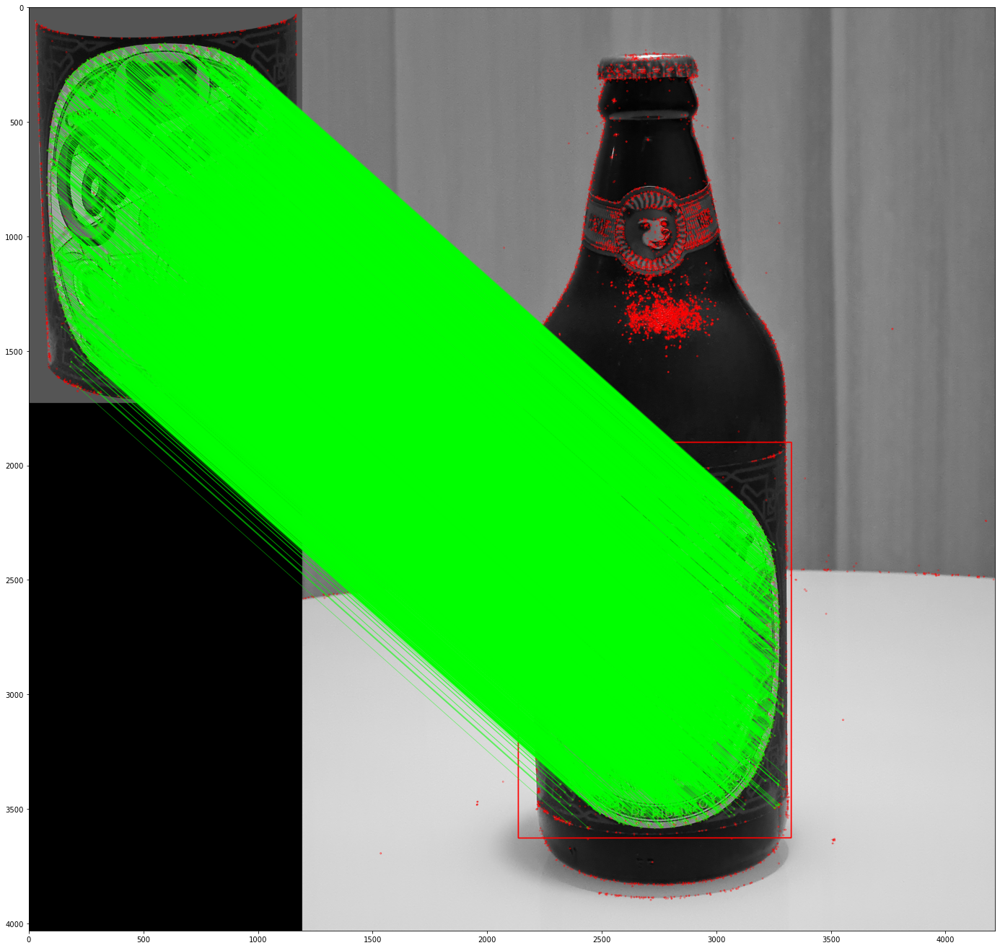

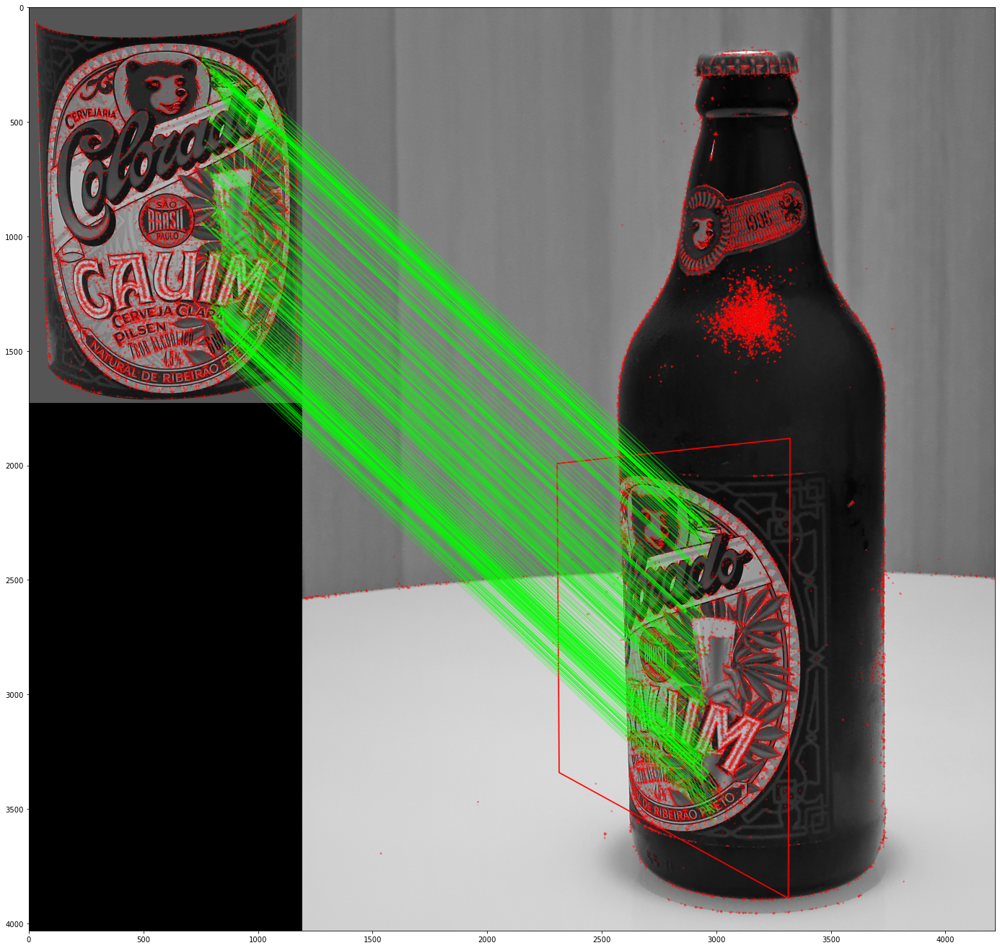

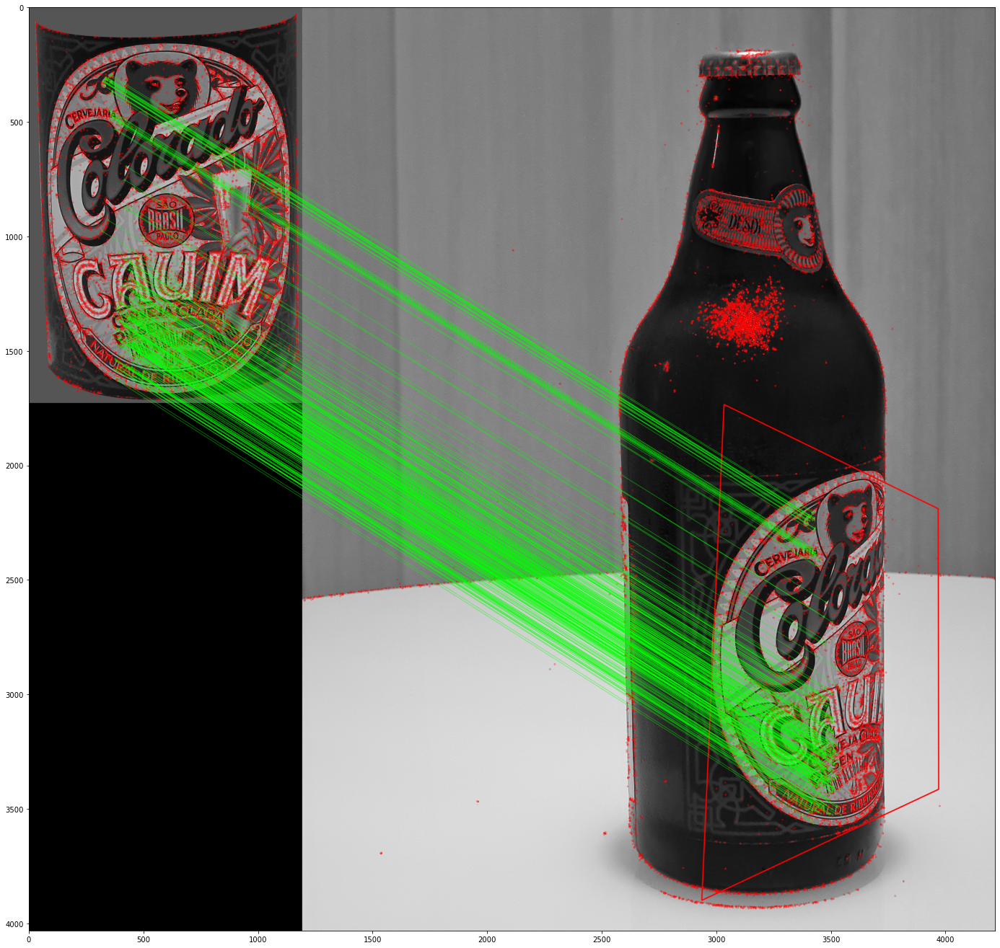

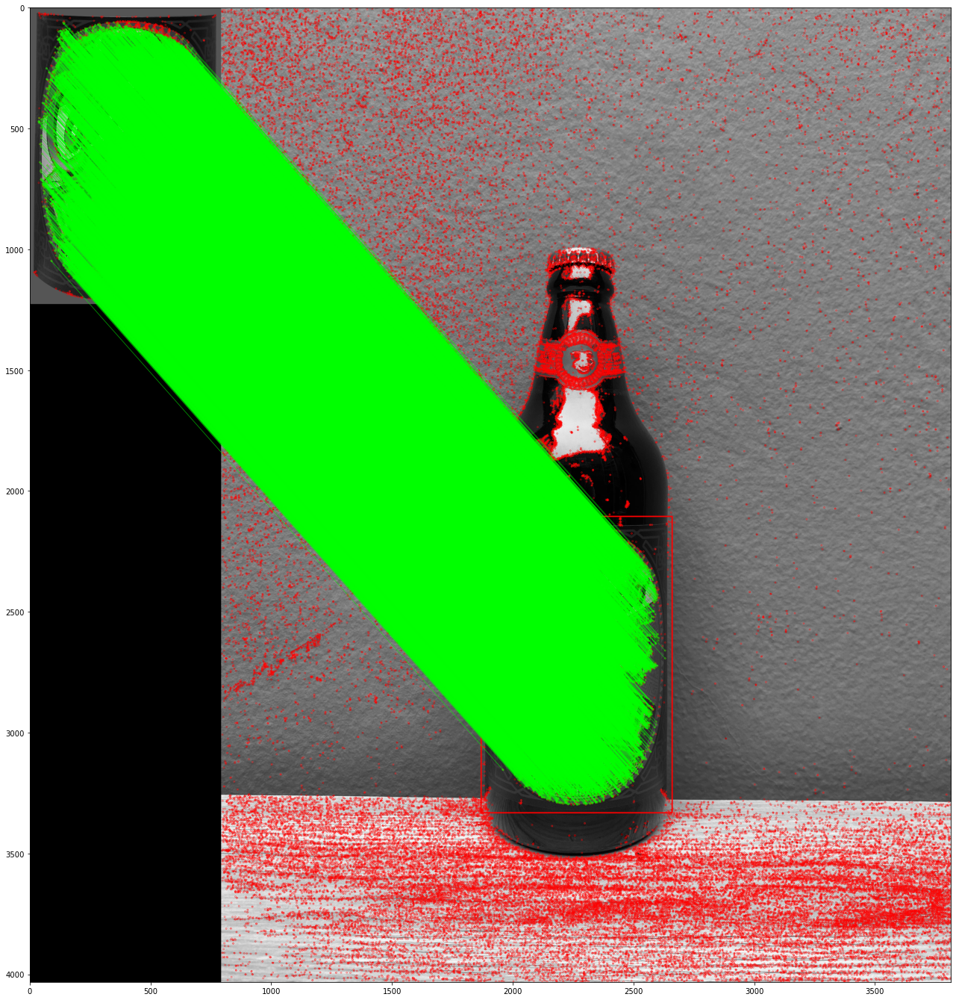

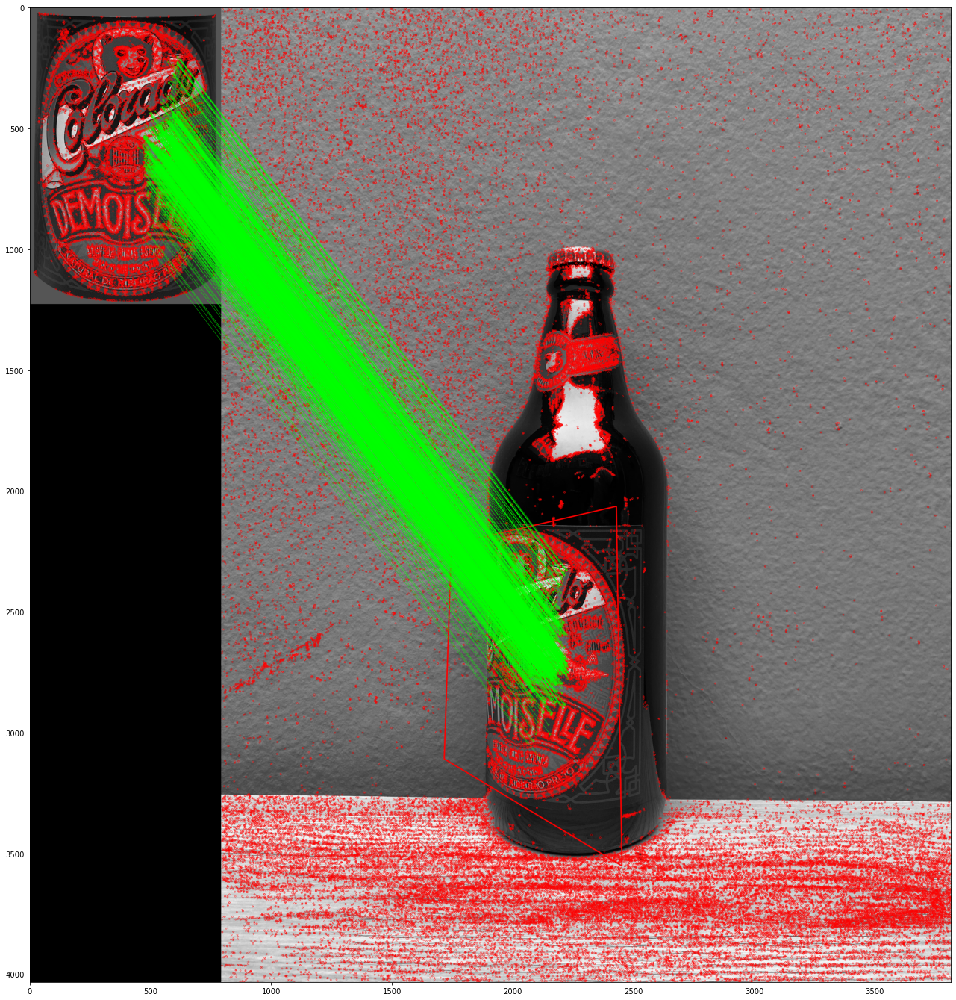

...

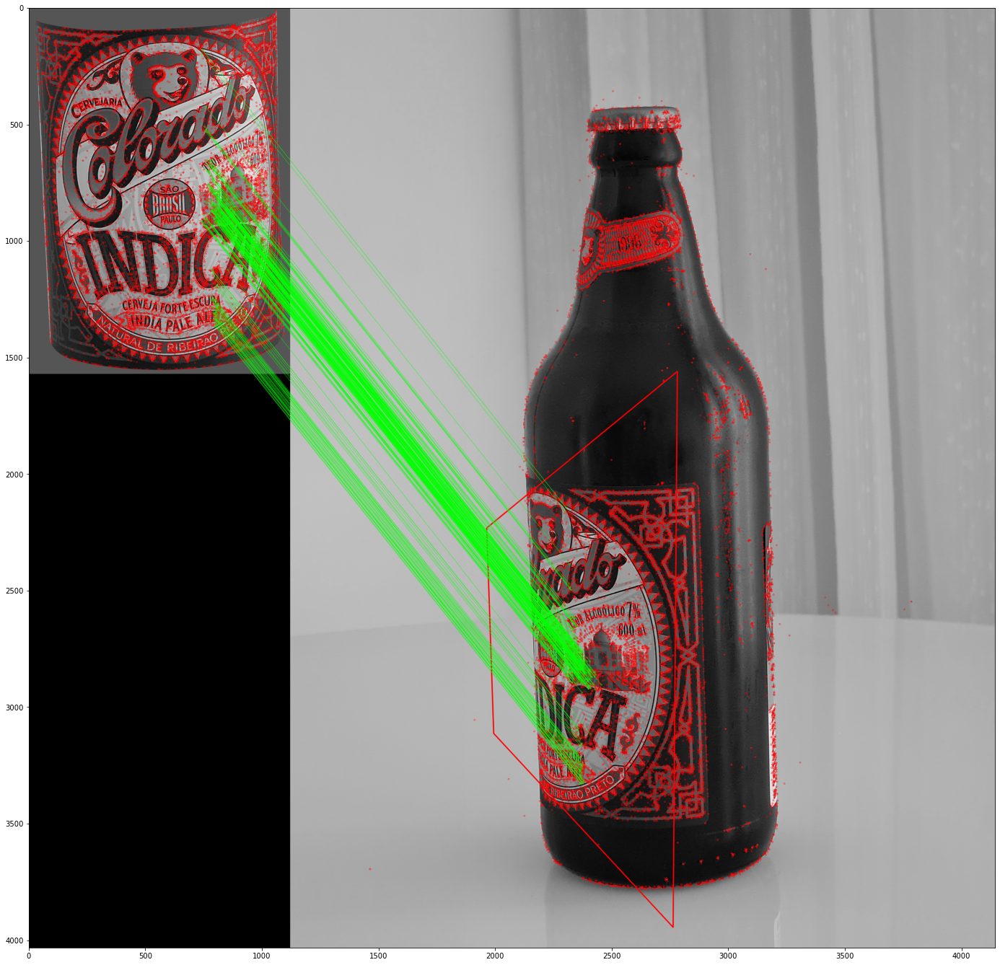

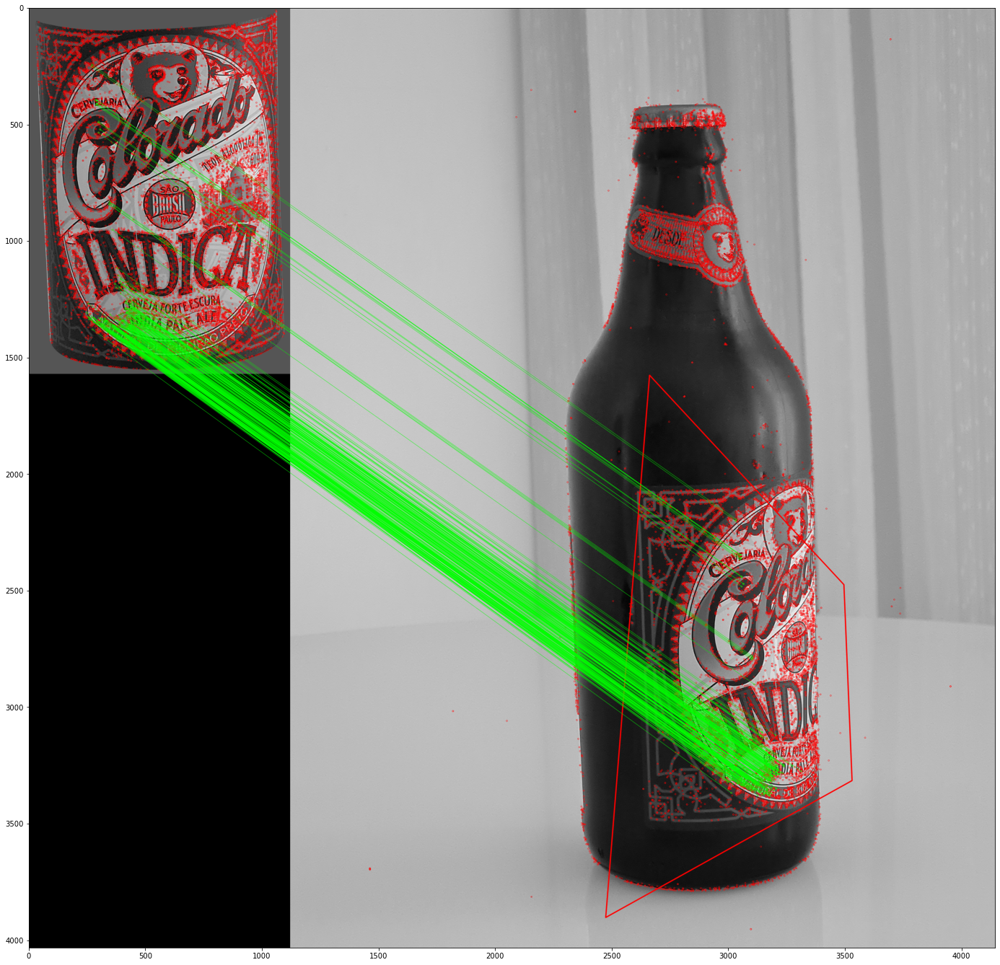

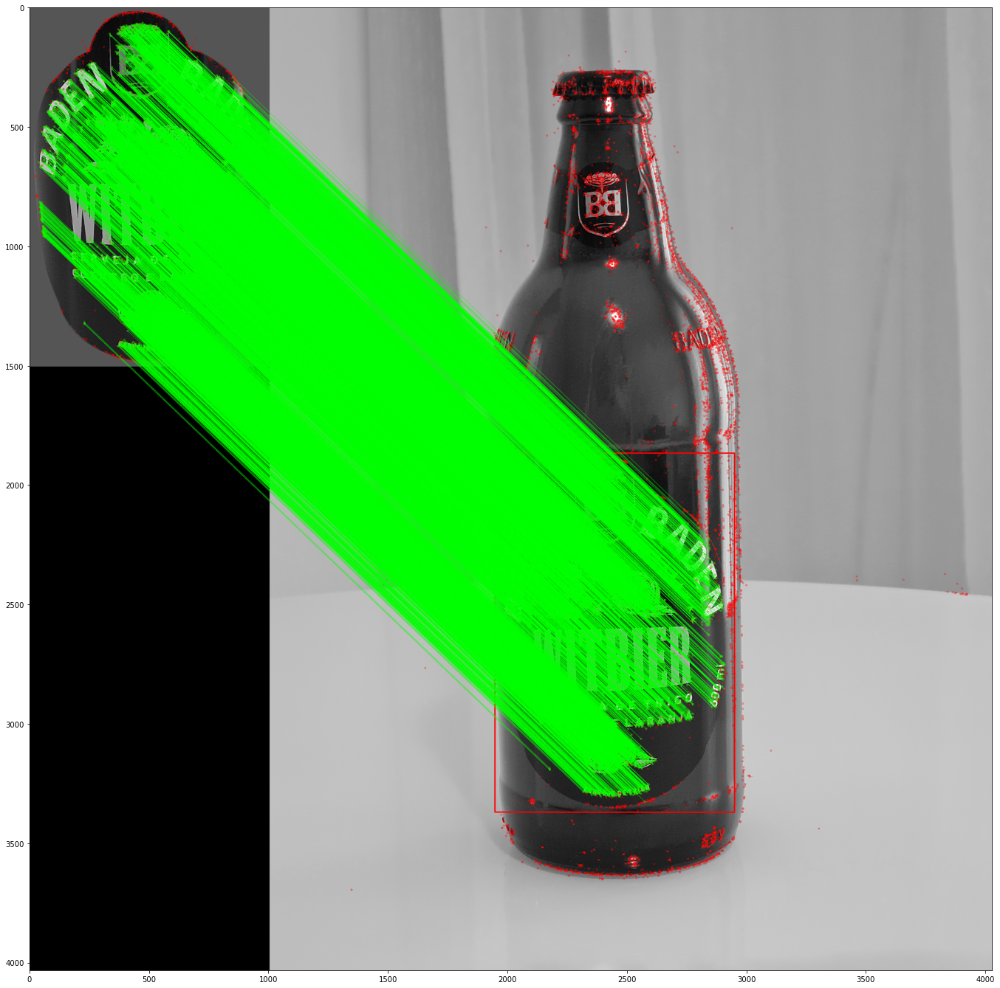

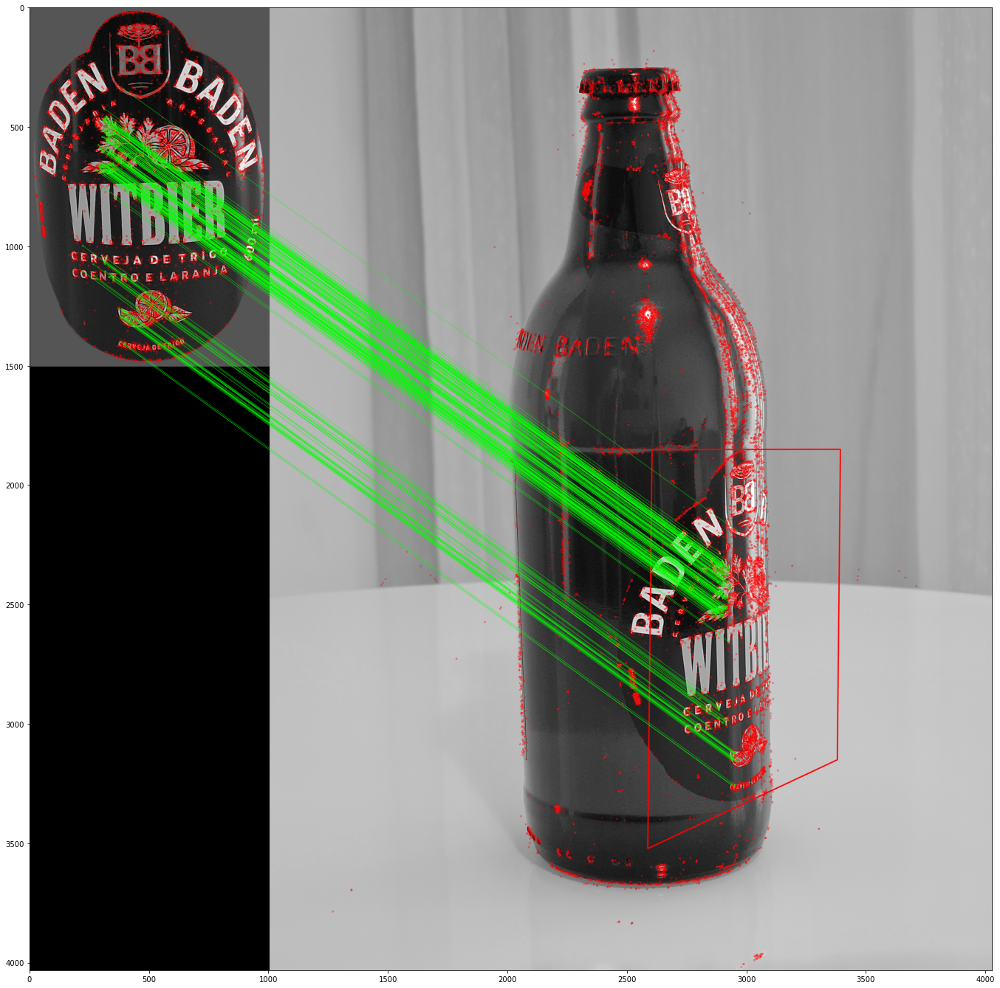

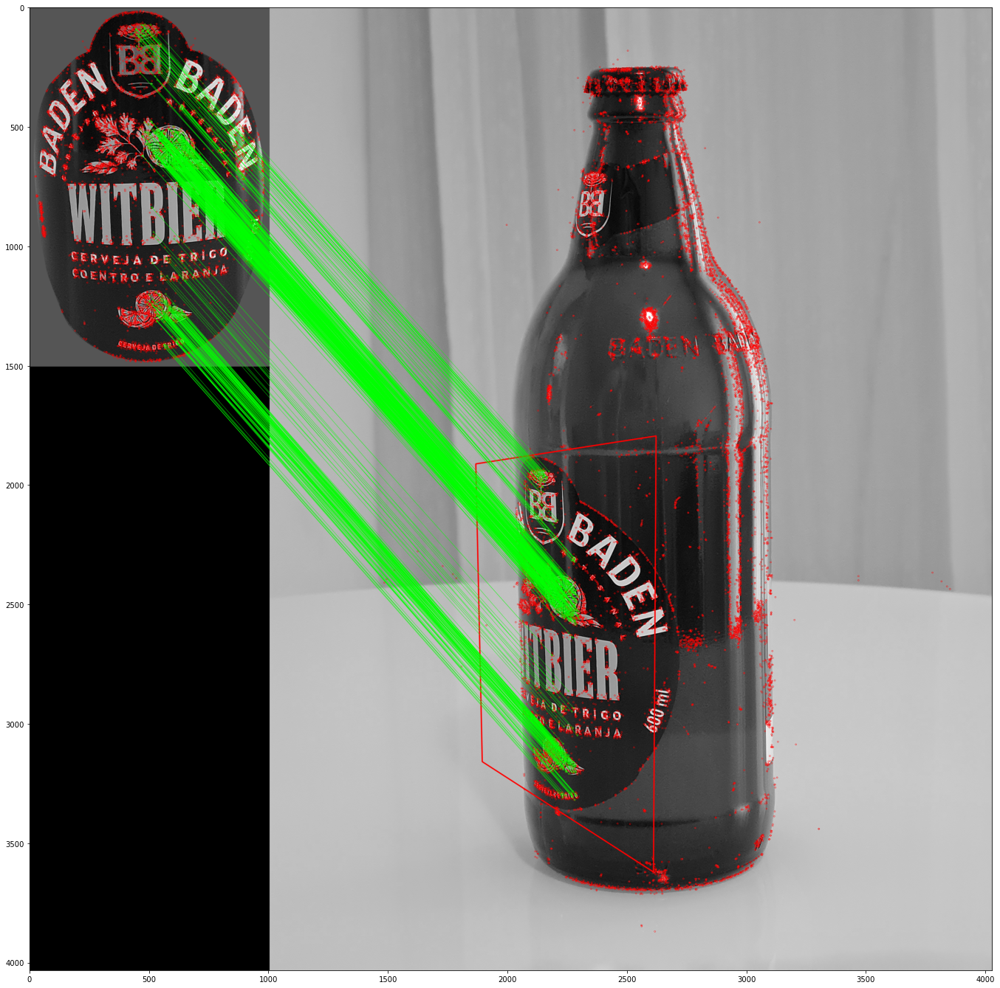

In [11]:
p_TwoSidesCheck = True
p_QuantitiesOfTheBestMatchings = 1

for model in models:
    #print(model['Name'])
    for idx, features in enumerate(model['OK']['Features']):
        matcher = cv2.BFMatcher(crossCheck = p_TwoSidesCheck)
        matches = matcher.knnMatch(model['Label']['Features'][0]['Descriptors'], features['Descriptors'], k = p_QuantitiesOfTheBestMatchings)
        
        
        img_result = cv2.drawMatchesKnn(model['Label']['ImagesReaded'][0], model['Label']['Features'][0]['Keypoints'], 
                                        model['OK']['ImagesReaded'][idx], features['Keypoints'], 
                                        matches, None, matchColor=(0, 255, 0), matchesMask=None,
                                        singlePointColor=(255, 0, 0), flags=0)

        #plt.figure(figsize=[24,24])
        #plt.imshow(img_result)
        
        
        
        
        ## Find homography
        matches_to_find = matches

        if type(matches_to_find[0]) is list:
            matches_to_find_plain = []
            for m in matches_to_find:
                if type(m) is list:
                    for n in m:
                        matches_to_find_plain.append(n)

            matches_to_find = matches_to_find_plain

        # Get positions of matching keypoints
        keypoints_label_pos = np.zeros([len(matches_to_find), 2], dtype=np.float32)
        keypoints_scene_pos = np.zeros([len(matches_to_find), 2], dtype=np.float32)

        for i, m in enumerate(matches_to_find):
            keypoints_label_pos[i] = model['Label']['Features'][0]['Keypoints'][m.queryIdx].pt
            keypoints_scene_pos[i] = features['Keypoints'][m.trainIdx].pt

        # T is the transformation matrix, mask is a boolean array indicating inlier points
        T, mask = cv2.findHomography(keypoints_label_pos, keypoints_scene_pos, 
                                     cv2.RANSAC, ransacReprojThreshold=3.0) 
        matchesMask = mask.ravel().tolist()
        
        
        label_img = cv2.cvtColor(model['Label']['ImagesReaded'][0], cv2.COLOR_BGR2GRAY)
            
        # Find transformation of rectangle delimiting object
        h, w = label_img.shape
        label_bounds = np.float32([[0,0], [0,h-1], [w-1,h-1], [w-1,0] ]).reshape(-1,1,2)
        label_bounds_in_scene = cv2.perspectiveTransform(label_bounds, T)

        # Draw polygon in the scene
        img_scene_box = cv2.polylines(model['OK']['ImagesReaded'][idx].copy(), [np.int32(label_bounds_in_scene)], True, 255, 3, cv2.LINE_AA)

        img_matches_RANSAC = cv2.drawMatches(model['Label']['ImagesReaded'][0], model['Label']['Features'][0]['Keypoints'], 
                                             img_scene_box, features['Keypoints'], 
                                             matches_to_find, None, matchColor=(0, 255, 0), matchesMask=matchesMask,
                                             singlePointColor=(255, 0, 0), flags=0)

        plt.figure(figsize=[24,24])
        plt.imshow(img_matches_RANSAC, 'gray')
        #print("---------------------------------")

# 6 Find Artifacts
Here the points will be found among labels and scenes

# 7 Artifacts Detected With Great Results
Here the points will be detected among labels and scenes with great results and the POC will be proved